# Importing libraries and loading data

In [1]:
# Install Python packages using pip.

# The "!pip" command allows you to run shell commands in Jupyter Notebook or Colab cells.
# It is used here to install Python packages.
# The "-q" flag stands for "quiet," which means it will suppress output during installation.
# "feature_engine," "autoviz," and "dataprep" are the packages being installed.
# The "2>/dev/null" part redirects any error messages (stderr) to the null device, effectively silencing them.
# This is often used when you want to hide installation messages.
#!pip install -q feature_engine autoviz>=0.1.803 dataprep 2>/dev/null
%pip install -q feature_engine autoviz>=0.1.803

Note: you may need to restart the kernel to use updated packages.


  error: subprocess-exited-with-error
  
  × Preparing metadata (pyproject.toml) did not run successfully.
  │ exit code: 1
  ╰─> [145 lines of output]
      setup.py:461: UserWarning: Unrecognized setuptools command ('dist_info --egg-base C:\Users\tuanq\AppData\Local\Temp\pip-modern-metadata-rz7qos0e'), proceeding with generating Cython sources and expanding templates
        warnings.warn("Unrecognized setuptools command ('{}'), proceeding with "
      setup.py:563: DeprecationWarning:
      
        `numpy.distutils` is deprecated since NumPy 1.23.0, as a result
        of the deprecation of `distutils` itself. It will be removed for
        Python >= 3.12. For older Python versions it will remain present.
        It is recommended to use `setuptools < 60.0` for those Python versions.
        For more details, see:
          https://numpy.org/devdocs/reference/distutils_status_migration.html
      
      
        from numpy.distutils.core import setup
      Running from SciPy source

In [3]:
%pip install numpy pandas warnings

  Using cached numpy-2.0.0-cp310-cp310-win_amd64.whl (16.5 MB)
  Using cached pandas-2.2.2-cp310-cp310-win_amd64.whl (11.6 MB)
Note: you may need to restart the kernel to use updated packages.


ERROR: Could not find a version that satisfies the requirement warnings (from versions: none)
ERROR: No matching distribution found for warnings


In [2]:
%pip install dataprep

  Using cached dataprep-0.4.5-py3-none-any.whl (9.9 MB)
  Using cached ipywidgets-7.8.1-py2.py3-none-any.whl (124 kB)
  Using cached rapidfuzz-2.15.2-cp310-cp310-win_amd64.whl (1.8 MB)
  Using cached SQLAlchemy-1.3.24.tar.gz (6.4 MB)
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
     -------------------------------------- 158.9/158.9 kB 1.1 MB/s eta 0:00:00
  Using cached Jinja2-3.0.3-py3-none-any.whl (133 kB)
  Using cached wordcloud-1.9.3-cp310-cp310-win_amd64.whl (299 kB)
  Using cached dask-2024.6.2-py3-none-any.whl (1.2 MB)
  Using cached tqdm-4.66.4-py3-none-any.whl (78 kB)
  Using cached bokeh-2.4.3-py3-none-any.whl (18.5 MB)
  Using cached flask-2.3.3-py3-none-any.whl (96 kB)
  Using cached Flask_Cors-3.0.10-py2.py3-none-any.whl (14 kB)
     -------------------------------------- 273.3/273.3 kB 3.4 MB/s eta 0:00:00
  Using cached Metaphone-0.6.tar.gz (14 kB)
  Preparing metadata (setup.py): started
  Preparing metadata (se

  error: subprocess-exited-with-error
  
  × pip subprocess to install build dependencies did not run successfully.
  │ exit code: 1
  ╰─> [241 lines of output]
      Ignoring numpy: markers 'python_version == "3.7" and (platform_machine != "arm64" or platform_system != "Darwin") and platform_machine != "aarch64"' don't match your environment
      Ignoring numpy: markers 'python_version == "3.8" and (platform_machine != "arm64" or platform_system != "Darwin") and platform_machine != "aarch64"' don't match your environment
      Ignoring numpy: markers 'python_version == "3.7" and platform_machine == "aarch64"' don't match your environment
      Ignoring numpy: markers 'python_version == "3.8" and platform_machine == "aarch64"' don't match your environment
      Ignoring numpy: markers 'python_version == "3.8" and platform_machine == "arm64" and platform_system == "Darwin"' don't match your environment
      Ignoring numpy: markers 'python_version == "3.9" and platform_machine == "arm6

In [3]:
# Import necessary libraries
import numpy as np  # Import NumPy for handling numerical operations
import pandas as pd  # Import Pandas for data manipulation and analysis
import warnings  # Import Warnings to suppress unnecessary warnings

# Suppress warning messages
warnings.filterwarnings("ignore")

# Import AutoViz from the autoviz library for automated visualization of data
from autoviz import AutoViz_Class

# Import load_dataset and create_report from the dataprep library for data loading and EDA
from dataprep.datasets import load_dataset
from dataprep.eda import create_report

# Import SHAP for interpreting model predictions
import shap

# Import matplotlib for data visualization
import matplotlib.pyplot as plt

# Import CatBoostRegressor for building a regression model
from catboost import Pool, CatBoostRegressor

# Import mean_squared_error for evaluating model performance
from sklearn.metrics import mean_squared_error

# Import train_test_split for splitting the data into training and testing sets
from sklearn.model_selection import train_test_split

# Import RareLabelEncoder from feature_engine.encoding for encoding categorical features
from feature_engine.encoding import RareLabelEncoder

# Import CountVectorizer from sklearn.feature_extraction.text for text feature extraction
from sklearn.feature_extraction.text import CountVectorizer

# Import ast and re for working with text and regular expressions
import ast
import re

# Set Pandas options to display a maximum of 1000 rows
pd.set_option('display.max_rows', 1000)


Imported v0.1.901. Please call AutoViz in this sequence:
    AV = AutoViz_Class()
    %matplotlib inline
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)


In [4]:
%%time
df = pd.read_csv('./car_detail_en.csv/car_detail_en.csv/car_detail_en.csv') # Reads the dataset from a CSV file into a Pandas DataFrame
item0 = df.shape[0]  # Stores the initial number of rows in the DataFrame
df = df.drop_duplicates()  # Removes duplicate rows from the DataFrame
item1 = df.shape[0]  # Stores the number of rows after removing duplicates
print(f"There are {item0-item1} duplicates found in the dataset")  # Prints the number of duplicates that were removed

# Function to convert values to numerical
def convert_to_numeric(value):
    try:
        if 'Billion' in value and not 'Million' in value:
            return float(value.replace('Billion', '').replace(' ', '')) * 1e3
        elif 'Million' in value and not 'Billion' in value:
            return float(value.replace('Million', '').replace(' ', ''))
        else:
            return float(value.replace('Million', '').replace('Billion', '').replace(' ', ''))
    except:
        return None
df['log10_price'] = np.log10(df['price. price'].apply(convert_to_numeric))

df = df[~df['log10_price'].isnull()]

# log10-transform mileage
def log10_mileage(x):
    try:
        return str(round(1/5*round(5*np.log10(int(str(x).rstrip(' Km').replace(',',''))+1)),1))
    except:
        return 'None'
    
df['log10_mileage'] = df['mileage'].apply(log10_mileage)

def get_fuel_consumption(x):
    res = str(x).replace('L/100Km','').rstrip('\t')
    if res:
        return res
    else:
        return 'None'

df['fuel_consumption'] = df['fuel_consumption'].apply(get_fuel_consumption)

df['fuel_type'] = df['engine'].apply(lambda x: str(x).split('\t')[0])


def get_engine_size(x):
    res = str(x).split('\t')[-1]
    if ' L' in res:
        return res
    else:
        return 'None'
df['engine_size'] = df['engine'].apply(get_engine_size)

# combine brand an grade
df['brand_grade'] = df['brand'] + ' ' + df['grade']

# Select only specific columns of interest
selected_cols = ['log10_price', 'origin', 'condition', 'car_model', 'log10_mileage',
       'exterior_color', 'interior_color', 'num_of_doors', 'seating_capacity',
       'fuel_type', 'engine_size', 'transmission', 'drive_type',
       'fuel_consumption', 'brand_grade', 'year_of_manufacture']
df = df[selected_cols]

print(df.shape)  # Prints the dimensions (rows and columns) of the filtered DataFrame
df.sample(10).T  # Displays a random sample of 5 rows transposed for better visibility

There are 0 duplicates found in the dataset
(30480, 16)
CPU times: total: 281 ms
Wall time: 795 ms


,7159,15812,28933,384,18885,4580,13920,6450,20252,8409
log10_price,2.812245,3.103462,3.671173,3.053078,3.175802,3.518514,2.772322,2.755875,2.673942,2.770852
origin,Domestic assembly,Domestic assembly,Imported,Imported,Domestic assembly,Imported,Domestic assembly,Imported,Domestic assembly,Domestic assembly
condition,Used car,Used car,Used car,New car,Used car,Used car,New car,Used car,Used car,Used car
car_model,Sedan,SUV,SUV,SUV,SUV,SUV,Sedan,Bán tải / Pickup,Hatchback,SUV
log10_mileage,4.2,4.4,4.8,0.0,4.6,4.4,0.0,4.2,4.6,4.8
exterior_color,Red,Red,Black,Black,White,Red,Red,Green,White,White
interior_color,Black,Colorful,Brown,Black,Black,Yellow,Cream,Grey,Brown,Black
num_of_doors,4-door,5-door,5-door,5-door,5-door,5-door,4-door,4-door,5-door,5-door
seating_capacity,5-seat,7-seat,4-seat,7-seat,5-seat,5-seat,5-seat,5-seat,5-seat,5-seat
fuel_type,Petrol,Diesel,Petrol,Diesel,Petrol,Petrol,Petrol,Diesel,Petrol,Petrol


In [5]:
df.columns

Index(['log10_price', 'origin', 'condition', 'car_model', 'log10_mileage',
       'exterior_color', 'interior_color', 'num_of_doors', 'seating_capacity',
       'fuel_type', 'engine_size', 'transmission', 'drive_type',
       'fuel_consumption', 'brand_grade', 'year_of_manufacture'],
      dtype='object')

In [6]:
df.nunique()

log10_price            2052
origin                    2
condition                 2
car_model                10
log10_mileage            44
exterior_color           18
interior_color           18
num_of_doors             12
seating_capacity         23
fuel_type                 5
engine_size              60
transmission              4
drive_type                6
fuel_consumption         74
brand_grade             499
year_of_manufacture      34
dtype: int64

In [7]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
log10_price,30480.0,2.804430,0.413731,1.079181,2.583199,2.770115,2.963788,4.732394
year_of_manufacture,30451.0,2017.356901,5.287769,1990.000000,2015.000000,2019.000000,2022.000000,2023.000000


# Data visualisation

In [8]:
# An update taken from the nice work https://www.kaggle.com/code/anshtanwar/auto-eda-missing-migrants-interactive-charts 
# made by @anshtanwar

# Import the AutoViz_Class
# This class is used for automated exploratory data analysis and visualization.
AV = AutoViz_Class()

# Initialize variables
filename = ""  # Specify the filename of the dataset (empty in this case)
target_variable = 'log10_price'  # Specify the target variable for analysis
custom_plot_dir = "custom_plot_directory"  # Specify the directory to save custom plots

# Perform automated EDA using the AutoViz library
# The following parameters are used:
# - filename: Empty in this case as the data is provided directly as 'df'
# - sep: Delimiter used in the data (comma in this case)
# - depVar: Target variable for analysis ('rating' in this case)
# - dfte: DataFrame to be analyzed ('df' is assumed to be defined earlier)
# - header: Indicates that the first row contains column names (0 for True)
# - verbose: Verbosity level (1 for verbose output)
# - lowess: Smoothing using Lowess algorithm (False for no smoothing)
# - chart_format: Format in which charts will be generated (HTML format in this case)
# - max_rows_analyzed: Maximum number of rows to analyze (up to 10,000 rows)
# - max_cols_analyzed: Maximum number of columns to analyze (up to 50 columns)
# - save_plot_dir: Directory to save the generated plots ('custom_plot_directory' in this case)
try:
    dft = AV.AutoViz(
        filename,
        sep=",",
        depVar=target_variable,
        dfte=df,
        header=0,
        verbose=1,
        lowess=False,
        chart_format="html",
        max_rows_analyzed=min([df.shape[0], 10**4]),
        max_cols_analyzed=min([df.shape[1], 50]),
        save_plot_dir=custom_plot_dir
    )
    
except:
    pass

    Since nrows is smaller than dataset, loading random sample of 10000 rows into pandas...
Shape of your Data Set loaded: (10000, 16)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    Number of Numeric Columns =  1
    Number of Integer-Categorical Columns =  0
    Number of String-Categorical Columns =  11
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  2
    Number of Numeric-Boolean Columns =  0
    Number of Discrete String Columns =  1
    Number of NLP String Columns =  0
    Number of Date Time Columns =  0
    Number of ID Columns =  0
    Number of Columns to Delete =  0
    15 Predictors classified...
        No variables removed since no ID or low-information variables found in data set

Saving scatterplots in HTML format
Saving distplots_cats in HTML format 
Saving distplots_nums in HTML format           
Saving kde_plots in HTML format      
Saving violinplots in HTML format
Saving cat_var_plots in HTML format
                                               

W-1005 (FIXED_SIZING_MODE): 'fixed' sizing mode requires width and height to be set: Row(id='1943', ...)


Time to run AutoViz (in seconds) = 10


In [9]:
# Import the necessary library for displaying HTML content
from IPython.core.display import display, HTML

# Import the pathlib library to work with file paths
from pathlib import Path

# Initialize an empty list to store file names
file_names = []

# Use pathlib to iterate through HTML files in a specific directory
for file in Path(f'/kaggle/working/{custom_plot_dir}/{target_variable}/').glob('*.html'):

    # Extract the filename from the full path and add it to the list
    filename = str(file).split('/')[-1]
    file_names.append(filename)

# Iterate through the list of file names and display each HTML file
for file_name in file_names:

    # Construct the full file path for each HTML file
    file_path = f'/kaggle/working/{custom_plot_dir}/{target_variable}/{file_name}'

    # Open the HTML file for reading
    with open(file_path, 'r') as file:

        # Read the content of the HTML file
        html_content = file.read()

        # Display the HTML content using IPython
        display(HTML(html_content))

  0%|          | 0/1683 [00:00<?, ?it/s]

DataPrep Report
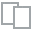
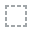
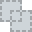
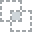
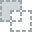
...
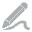
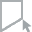
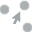
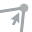
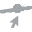

In [10]:
create_report(df.sample(10**4))

# Data transformation

In [11]:
# Accessing DataFrame columns
# This line of code retrieves the column names from a DataFrame called 'df'.
# It allows you to access and work with the names of the columns in the DataFrame.

df.columns

Index(['log10_price', 'origin', 'condition', 'car_model', 'log10_mileage',
       'exterior_color', 'interior_color', 'num_of_doors', 'seating_capacity',
       'fuel_type', 'engine_size', 'transmission', 'drive_type',
       'fuel_consumption', 'brand_grade', 'year_of_manufacture'],
      dtype='object')

In [12]:
df.sample(5).T

,14972,10771,5559,12446,3989
log10_price,3.518514,2.681241,3.716003,2.633468,2.812913
origin,Imported,Domestic assembly,Imported,Imported,Imported
condition,Used car,Used car,Used car,Used car,Used car
car_model,SUV,Sedan,Sedan,Bán tải / Pickup,SUV
log10_mileage,3.6,0.0,4.0,5.0,0.0
exterior_color,Black,White,Green,Black,Black
interior_color,Black,Cream,Brown,Black,Black
num_of_doors,5-door,4-door,4-door,4-door,5-door
seating_capacity,5-seat,5-seat,5-seat,5-seat,7-seat
fuel_type,Petrol,Petrol,Petrol,Diesel,Petrol


In [13]:
%%time

# Select the main label.
main_label = 'log10_price'

# Set up a rare label encoder for selected columns.
for col in df.columns:
    if col != main_label:
        df[col] = df[col].fillna('None').astype(str)
        encoder = RareLabelEncoder(n_categories=1, max_n_categories=150, replace_with='Other', tol=20.0 / df.shape[0])
        df[col] = encoder.fit_transform(df[[col]])

print(df.shape)  # Print the shape of the resulting DataFrame.
df.sample(10).T  # Display a sample of 10 rows, transposed for easier readability.

(30480, 16)
CPU times: total: 312 ms
Wall time: 573 ms


,10789,25308,3448,16884,2880,6027,16046,29493,25397,4084
log10_price,2.447158,3.280806,3.14145,2.752048,3.880814,2.671173,2.537819,2.628389,2.537819,2.880814
origin,Imported,Domestic assembly,Imported,Domestic assembly,Imported,Domestic assembly,Domestic assembly,Domestic assembly,Imported,Domestic assembly
condition,Used car,New car,New car,Used car,Used car,Used car,Used car,Used car,Used car,New car
car_model,SUV,SUV,Sedan,SUV,Sedan,Hatchback,Hatchback,Sedan,Hatchback,SUV
log10_mileage,0.0,0.0,0.0,5.0,4.4,3.6,4.6,4.8,4.6,0.0
exterior_color,Silver,White,Black,Silver,Green,Take note,White,White,Silver,Black
interior_color,gray,Cream,Black,gray,Cream,gray,Cream,Cream,Cream,Cream
num_of_doors,5-door,5-door,4-door,5-door,4-door,5-door,5-door,4-door,5-door,5-door
seating_capacity,8-seat,5-seat,5-seat,7-seat,4-seat,5-seat,5-seat,5-seat,5-seat,5-seat
fuel_type,Petrol,Petrol,Petrol,Diesel,Petrol,Petrol,Petrol,Petrol,Petrol,Petrol


In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30480 entries, 0 to 30651
Data columns (total 16 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   log10_price          30480 non-null  float64
 1   origin               30480 non-null  object 
 2   condition            30480 non-null  object 
 3   car_model            30480 non-null  object 
 4   log10_mileage        30480 non-null  object 
 5   exterior_color       30480 non-null  object 
 6   interior_color       30480 non-null  object 
 7   num_of_doors         30480 non-null  object 
 8   seating_capacity     30480 non-null  object 
 9   fuel_type            30480 non-null  object 
 10  engine_size          30480 non-null  object 
 11  transmission         30480 non-null  object 
 12  drive_type           30480 non-null  object 
 13  fuel_consumption     30480 non-null  object 
 14  brand_grade          30480 non-null  object 
 15  year_of_manufacture  30480 non-null 

In [15]:
df.sample(20).T 

,9574,11094,20514,13024,29983,21991,25934,22303,14167,11012,18103,10582,2988,1695,24221,8344,11759,27220,15764,935
log10_price,2.912753,2.744293,2.964731,2.597695,2.824776,2.376577,2.176091,2.525045,2.875061,3.056524,2.311754,2.90309,3.511883,2.799341,2.781755,2.541579,2.638489,2.638489,2.579784,2.136721
origin,Imported,Domestic assembly,Domestic assembly,Imported,Domestic assembly,Domestic assembly,Imported,Domestic assembly,Domestic assembly,Domestic assembly,Domestic assembly,Domestic assembly,Imported,Imported,Domestic assembly,Domestic assembly,Domestic assembly,Domestic assembly,Domestic assembly,Domestic assembly
condition,New car,Used car,New car,Used car,Used car,Used car,Used car,Used car,Used car,New car,Used car,Used car,Used car,New car,Used car,Used car,Used car,Used car,Used car,New car
car_model,Bán tải / Pickup,Sedan,SUV,Bán tải / Pickup,Sedan,SUV,SUV,Hatchback,Sedan,SUV,Hatchback,Crossover,SUV,SUV,SUV,Crossover,Sedan,Sedan,SUV,SUV
log10_mileage,0.0,4.6,0.0,5.0,4.6,4.2,4.6,4.4,4.0,0.0,0.0,5.2,3.4,0.0,4.8,0.0,4.8,5.0,5.0,0.0
exterior_color,White,Red,White,Take note,Other,Red,Red,Red,Red,White,Silver,White,Green,Silver,White,Silver,White,White,Red,Red
interior_color,Colorful,Black,Black,gray,-,Black,Colorful,Black,Black,Colorful,gray,White,Yellow,Black,Cream,gray,Black,Black,Black,Different color
num_of_doors,4-door,4-door,5-door,4-door,0-door,5-door,5-door,5-door,4-door,5-door,5-door,5-door,5-door,5-door,5-door,5-door,4-door,4-door,5-door,5-door
seating_capacity,5-seat,5-seat,7-seat,5-seat,0-seat,5-seat,7-seat,5-seat,5-seat,7-seat,5-seat,5-seat,5-seat,7-seat,8-seat,8-seat,5-seat,5-seat,5-seat,5-seat
fuel_type,Diesel,Petrol,Petrol,Diesel,Petrol,Petrol,Diesel,Petrol,Petrol,Diesel,Petrol,Petrol,Petrol,Petrol,Petrol,Petrol,Petrol,Petrol,Petrol,Electric


# Machine learning

In [47]:
%%time
# Initialize data
# Extract the values of the 'main_label' column and reshape it into a 1D array as 'y'
y = df[main_label].values.reshape(-1,)

# Create the feature matrix 'X' by dropping the 'main_label' column from the DataFrame 'df'
X = df.drop([main_label], axis=1)

# Identify categorical columns in the DataFrame 'df'
# These columns contain non-numeric data
cat_cols = df.select_dtypes(include=['object']).columns

# Create a list of indices for categorical columns in the feature matrix 'X'
cat_cols_idx = [list(X.columns).index(c) for c in cat_cols]

# Split the data into training and testing sets
# - 'X_train' and 'y_train' will contain the training features and labels, respectively
# - 'X_test' and 'y_test' will contain the testing features and labels, respectively
# The split is done with a 20% test size, a random seed of 0, and stratification based on the selected column
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0, stratify=df[['brand_grade']])

# Print the dimensions of the training and testing sets
# This provides insight into the sizes of the datasets
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

print(X_train.dtypes)
X_train.head()

(24384, 15) (6096, 15) (24384,) (6096,)
origin                 object
condition              object
car_model              object
log10_mileage          object
exterior_color         object
interior_color         object
num_of_doors           object
seating_capacity       object
fuel_type              object
engine_size            object
transmission           object
drive_type             object
fuel_consumption       object
brand_grade            object
year_of_manufacture    object
dtype: object
CPU times: total: 141 ms
Wall time: 337 ms


,origin,condition,car_model,log10_mileage,exterior_color,interior_color,num_of_doors,seating_capacity,fuel_type,engine_size,transmission,drive_type,fuel_consumption,brand_grade,year_of_manufacture
13551,Domestic assembly,Used car,SUV,1.0,Black,Black,5-door,5-seat,Petrol,2.0 L,Automatic,FWD - Front-wheel drive,6,Mazda CX5,2016.0
5255,Domestic assembly,Used car,Sedan,0.0,Silver,Colorful,4-door,5-seat,Petrol,1.5 L,Manual,FWD - Front-wheel drive,None,Toyota Vios,2015.0
18542,Domestic assembly,Used car,Sedan,5.0,White,Black,4-door,5-seat,Petrol,2.0 L,Automatic,FWD - Front-wheel drive,9,Mazda 6,2018.0
25555,Domestic assembly,Used car,Crossover,3.8,Green,Brown,5-door,5-seat,Petrol,1.6 L,Automatic,AWD - 4-wheel drive (AWD),None,Kia Sportage,2022.0
17938,Domestic assembly,Used car,Sedan,4.0,White,Cream,5-door,5-seat,Petrol,3.0 L,Automatic,RFD - Rear-wheel drive,None,Mercedes Benz S class,2019.0


In [48]:
%%time

# Initialize the training and testing data pools using CatBoost's Pool class
train_pool = Pool(X_train, 
                  y_train, 
                  cat_features=cat_cols_idx)  # Create a training data pool with categorical features
test_pool = Pool(X_test,
                 y_test,
                 cat_features=cat_cols_idx)  # Create a testing data pool with categorical features

# Specify the training parameters for the CatBoostRegressor model
model = CatBoostRegressor(iterations=1500,    # Number of boosting iterations
                          depth=6,           # Maximum depth of trees in the ensemble
                          verbose=0,         # Set verbosity level to 0 (no output during training)
                          learning_rate=0.1,  # Learning rate for gradient boosting
                          early_stopping_rounds=10, # Early stopping rounds
                          loss_function='RMSE')  # Loss function to optimize (Root Mean Squared Error)

# Train the CatBoostRegressor model on the training data
model.fit(train_pool, eval_set=test_pool)

# Make predictions using the trained model on both the training and testing data
y_train_pred = model.predict(train_pool)  # Predictions on the training data
y_test_pred = model.predict(test_pool)    # Predictions on the testing data

# Calculate and print the Root Mean Squared Error (RMSE) scores for training and testing data
rmse_train = mean_squared_error(y_train, y_train_pred, squared=False)  # RMSE for training data
rmse_test = mean_squared_error(y_test, y_test_pred, squared=False)     # RMSE for testing data
# Print the rounded RMSE scores
print(f"RMSE score for train {round(rmse_train, 4)} dex, and for test {round(rmse_test, 4)} dex")


RMSE score for train 0.149 dex, and for test 0.1672 dex
CPU times: total: 51.9 s
Wall time: 57.1 s


In [49]:
# Print the Accuracy Metrics in catboost 
print(model.score(X_train,y_train))
print(model.score(X_test,y_test))

0.8698851478677694
0.8381778978634056


In [44]:
params = model.get_params()
print(params)

{'iterations': 1500, 'learning_rate': 0.1, 'depth': 6, 'loss_function': 'RMSE', 'verbose': 0, 'early_stopping_rounds': 10}


In [50]:
# Calculate the baseline RMSE (Root Mean Squared Error) scores for the training and test datasets.

# For the training dataset:

# Calculate the RMSE by comparing the actual target values (y_train) with the predicted values,
# where the predicted values are the mean of the training target values repeated for each data sample.
rmse_bs_train = mean_squared_error(y_train, [np.mean(y_train)]*len(y_train), squared=False)

# For the test dataset:

# Calculate the RMSE by comparing the actual target values (y_test) with the predicted values,
# where the predicted values are the mean of the training target values repeated for each test data sample.
rmse_bs_test = mean_squared_error(y_test, [np.mean(y_train)]*len(y_test), squared=False)

# Print the rounded baseline RMSE scores for both the training and test datasets.
print(f"RMSE baseline score for train {round(rmse_bs_train, 4)} dex, and for test {round(rmse_bs_test, 4)} dex")

RMSE baseline score for train 0.4132 dex, and for test 0.4158 dex


# Explanations with SHAP values

In [19]:
%matplotlib inline

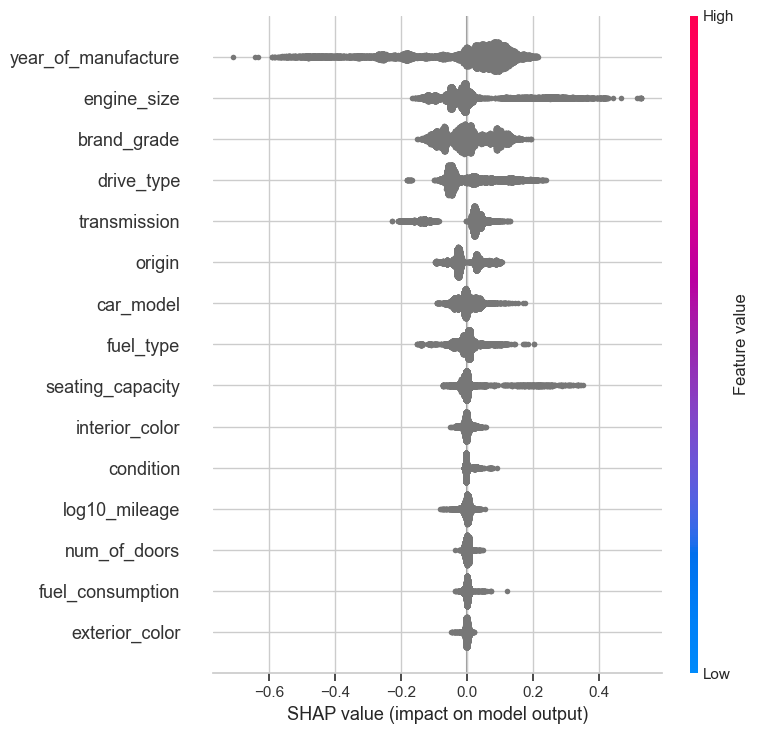

CPU times: total: 2.41 s
Wall time: 2.42 s


In [20]:
%%time
# Initialize the SHAP library for visualization
shap.initjs()

# Create a TreeExplainer object for the 'model' (assumes 'model' is a tree-based model like a Random Forest or XGBoost)
ex = shap.TreeExplainer(model)

# Calculate SHAP values for the 'X_test' data using the TreeExplainer
shap_values = ex.shap_values(X_test)

# Generate a summary plot to visualize the impact of features on model predictions
shap.summary_plot(shap_values, X_test)

In [21]:
# Calculate the expected values using a variable named 'ex.expected_value'.
expected_values = ex.expected_value

# Print the average predicted label
print(f"Average predicted price is {round(10**expected_values):,} million VND")

# Print the average actual label from 'y_test'
print(f"Average actual price is {round(10**np.mean(y_test)):,} million VND")

Average predicted price is 639 million VND
Average actual price is 636 million VND



origin



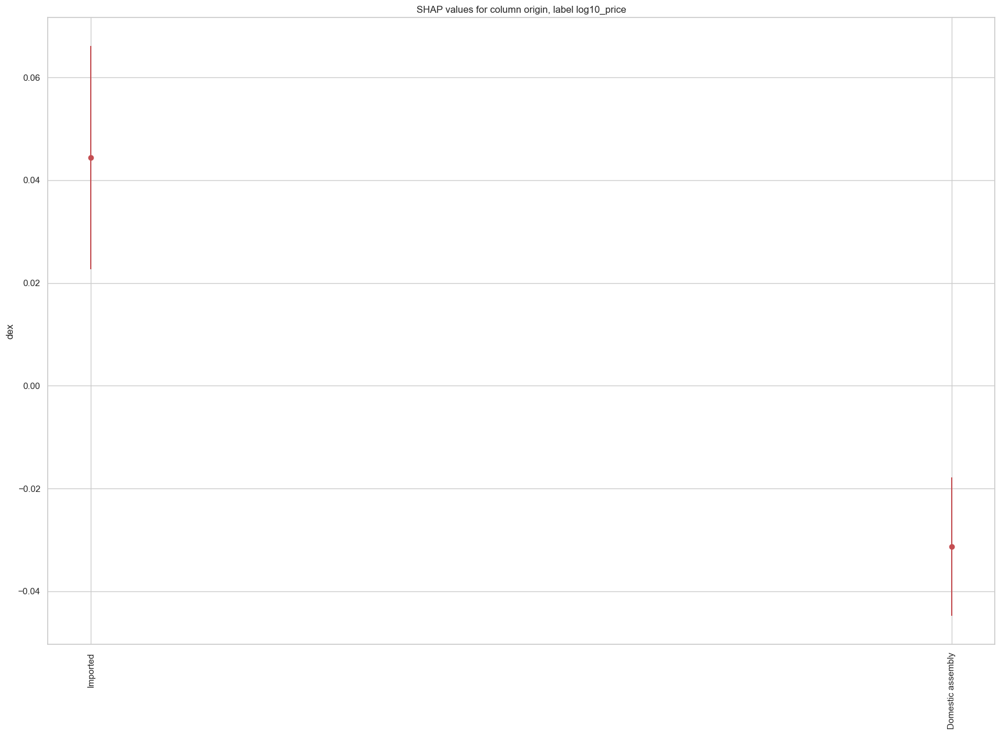

                    gain   gain_std  count
col                                       
Imported           0.0444   0.0217   6339 
Domestic assembly -0.0313   0.0135   8901 

condition



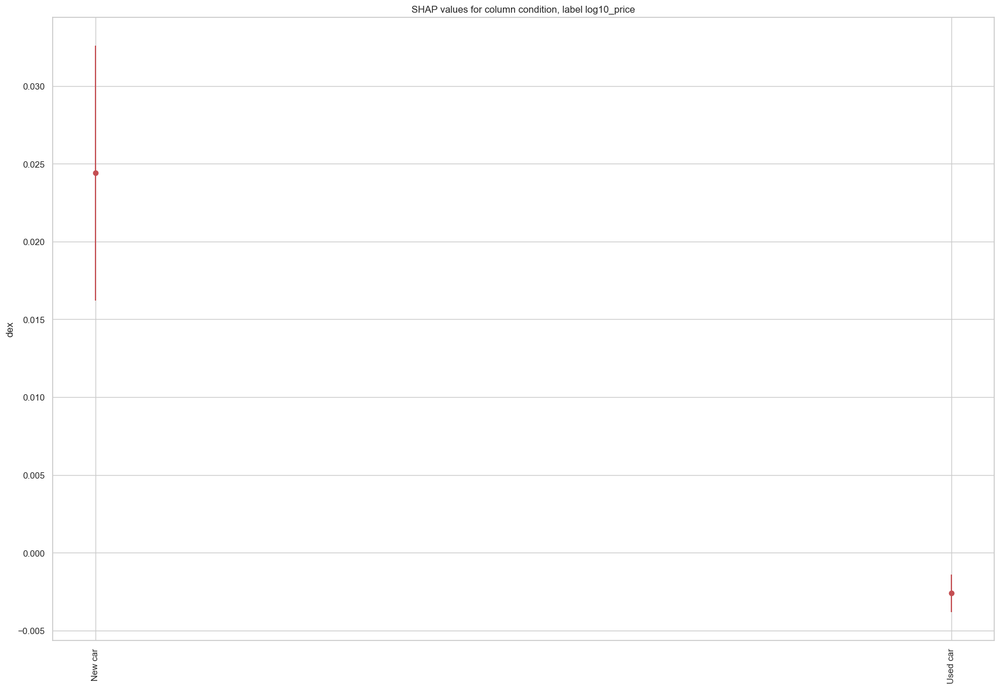

           gain   gain_std  count
col                              
New car   0.0244   0.0082    3028
Used car -0.0026   0.0012   12212

car_model



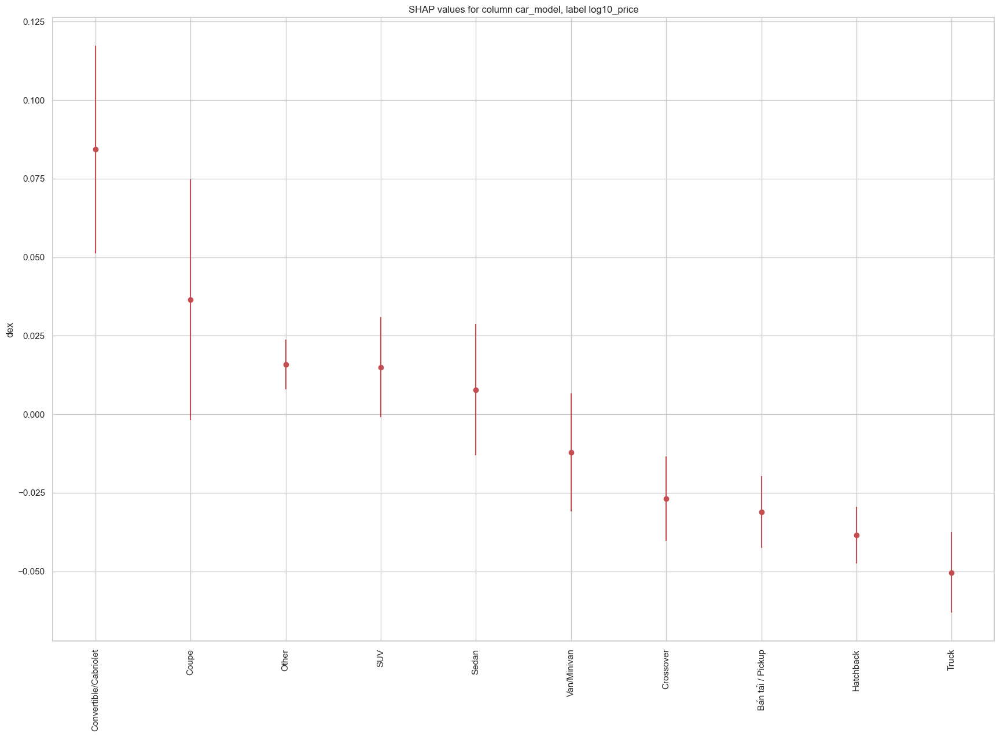

                        gain   gain_std  count
col                                           
Convertible/Cabriolet  0.0843   0.0330     53 
Coupe                  0.0365   0.0383     72 
Other                  0.0158   0.0079      3 
SUV                    0.0150   0.0159   5308 
Sedan                  0.0078   0.0209   5120 
Van/Minivan           -0.0121   0.0188    546 
Crossover             -0.0269   0.0134   1369 
Bán tải / Pickup    -0.0311   0.0114   1192 
Hatchback             -0.0385   0.0091   1365 
Truck                 -0.0504   0.0128    212 

log10_mileage



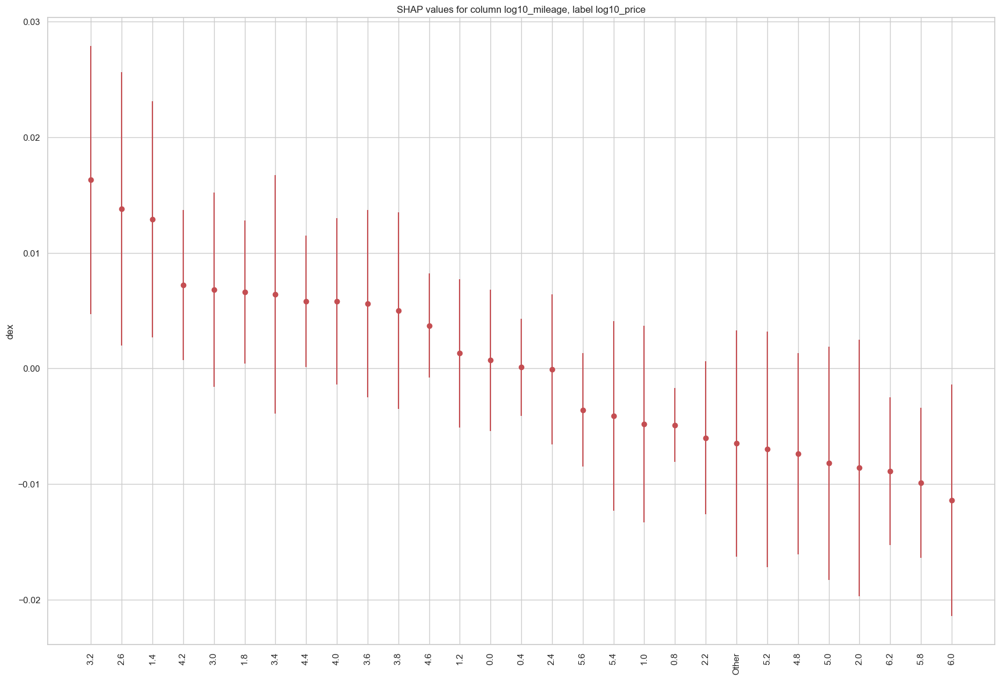

        gain   gain_std  count
col                           
3.2    0.0163   0.0116     32 
2.6    0.0138   0.0118     22 
1.4    0.0129   0.0102     22 
4.2    0.0072   0.0065    789 
3.0    0.0068   0.0084     57 
1.8    0.0066   0.0062     30 
3.4    0.0064   0.0103     91 
4.4    0.0058   0.0057   1357 
4.0    0.0058   0.0072    733 
3.6    0.0056   0.0081    170 
3.8    0.0050   0.0085    200 
4.6    0.0037   0.0045   1894 
1.2    0.0013   0.0064     17 
0.0    0.0007   0.0061   5223 
0.4    0.0001   0.0042     12 
2.4   -0.0001   0.0065     16 
5.6   -0.0036   0.0049     36 
5.4   -0.0041   0.0082    163 
1.0   -0.0048   0.0085     27 
0.8   -0.0049   0.0032     10 
2.2   -0.0060   0.0066     11 
Other -0.0065   0.0098     70 
5.2   -0.0070   0.0102    513 
4.8   -0.0074   0.0087   1985 
5.0   -0.0082   0.0101   1628 
2.0   -0.0086   0.0111     41 
6.2   -0.0089   0.0064     16 
5.8   -0.0099   0.0065     35 
6.0   -0.0114   0.0100     40 

exterior_color



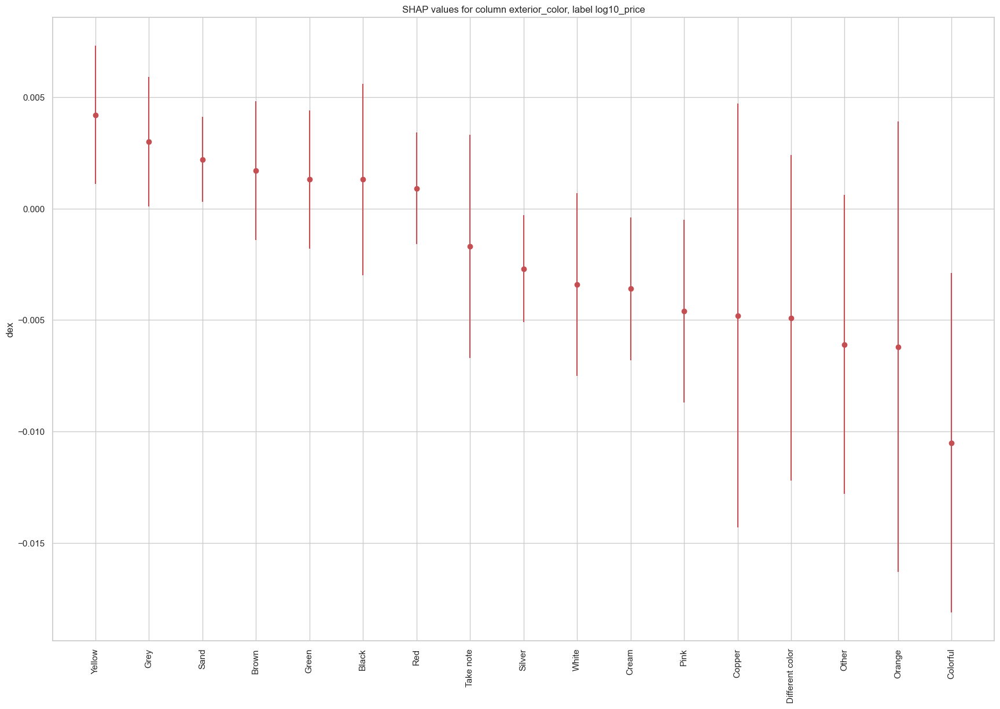

                  gain   gain_std  count
col                                     
Yellow           0.0042   0.0031    353 
Grey             0.0030   0.0029    534 
Sand             0.0022   0.0019    340 
Brown            0.0017   0.0031    406 
Green            0.0013   0.0031   1180 
Black            0.0013   0.0043   3385 
Red              0.0009   0.0025   1969 
Take note       -0.0017   0.0050    275 
Silver          -0.0027   0.0024   1397 
White           -0.0034   0.0041   4963 
Cream           -0.0036   0.0032     22 
Pink            -0.0046   0.0041     28 
Copper          -0.0048   0.0095    118 
Different color -0.0049   0.0073     20 
Other           -0.0061   0.0067     14 
Orange          -0.0062   0.0101    219 
Colorful        -0.0105   0.0076     17 

interior_color



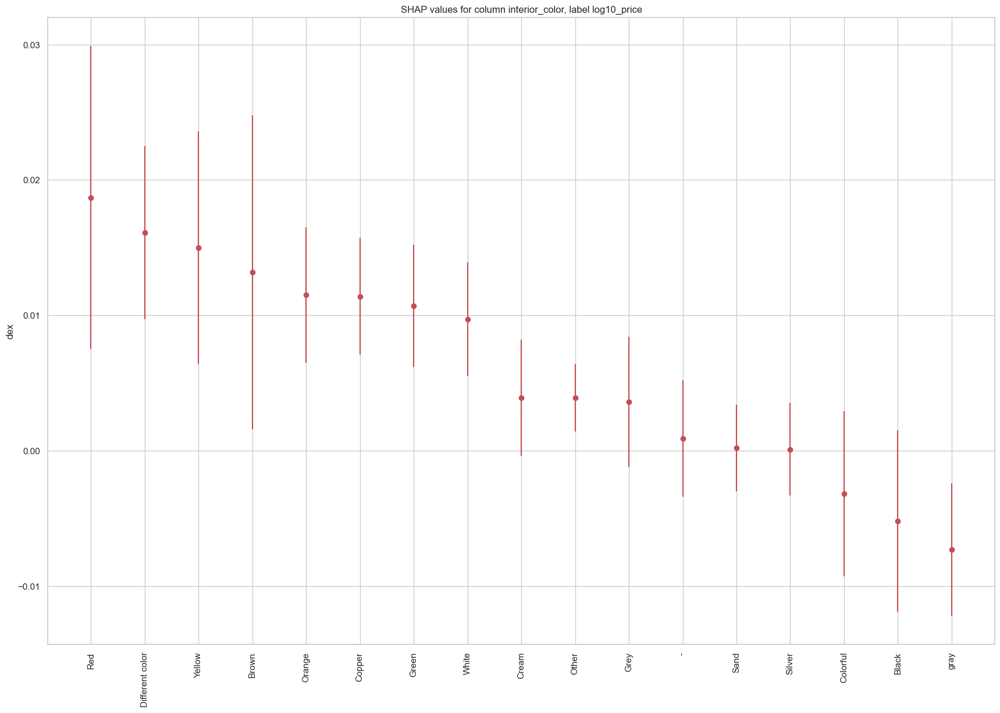

                  gain   gain_std  count
col                                     
Red              0.0187   0.0112    281 
Different color  0.0161   0.0064    212 
Yellow           0.0150   0.0086    224 
Brown            0.0132   0.0116   1829 
Orange           0.0115   0.0050     45 
Copper           0.0114   0.0043     23 
Green            0.0107   0.0045     69 
White            0.0097   0.0042    142 
Cream            0.0039   0.0043   3097 
Other            0.0039   0.0025     14 
Grey             0.0036   0.0048    332 
-                0.0009   0.0043    432 
Sand             0.0002   0.0032     46 
Silver           0.0001   0.0034     93 
Colorful        -0.0032   0.0061    952 
Black           -0.0052   0.0067   6251 
gray            -0.0073   0.0049   1198 

num_of_doors



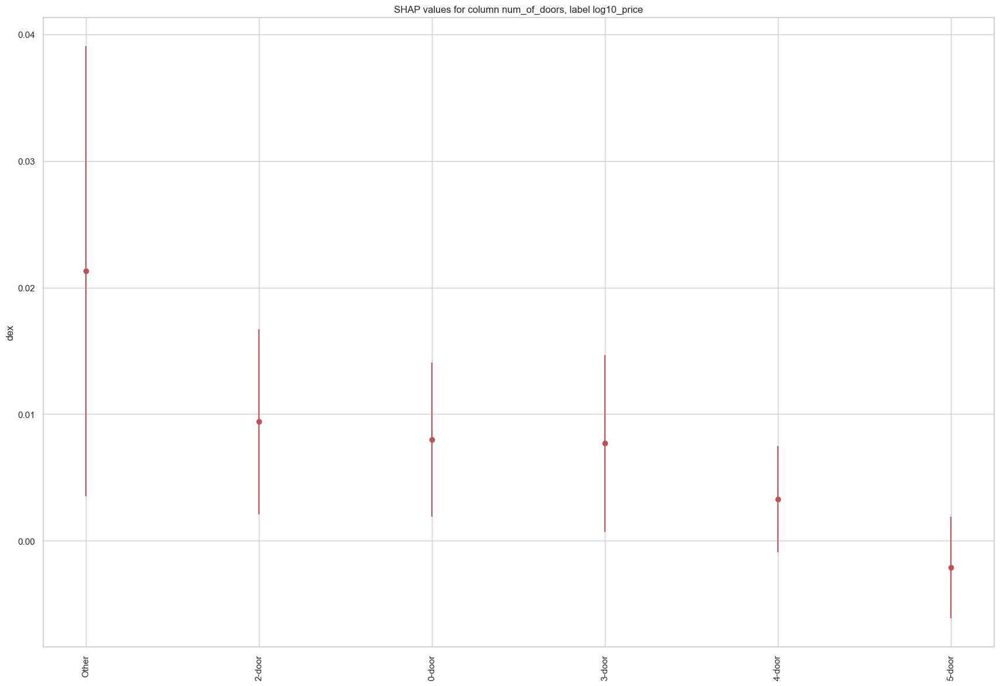

         gain   gain_std  count
col                            
Other   0.0213   0.0178     20 
2-door  0.0094   0.0073    331 
0-door  0.0080   0.0061     36 
3-door  0.0077   0.0070     28 
4-door  0.0033   0.0042   6530 
5-door -0.0021   0.0040   8295 

seating_capacity



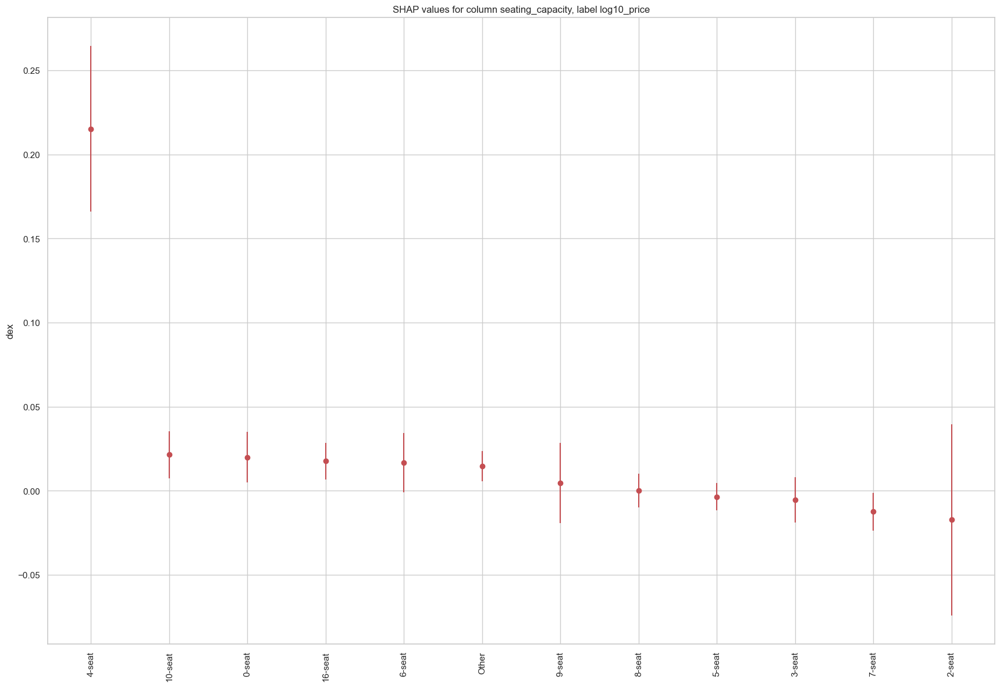

          gain   gain_std  count
col                             
4-seat   0.2153   0.0494     299
10-seat  0.0214   0.0139      19
0-seat   0.0199   0.0150      31
16-seat  0.0176   0.0108      71
6-seat   0.0168   0.0177      58
Other    0.0146   0.0089      15
9-seat   0.0045   0.0239      18
8-seat   0.0002   0.0101     875
5-seat  -0.0036   0.0082   10612
3-seat  -0.0055   0.0134     168
7-seat  -0.0125   0.0112    2857
2-seat  -0.0172   0.0569     217

fuel_type



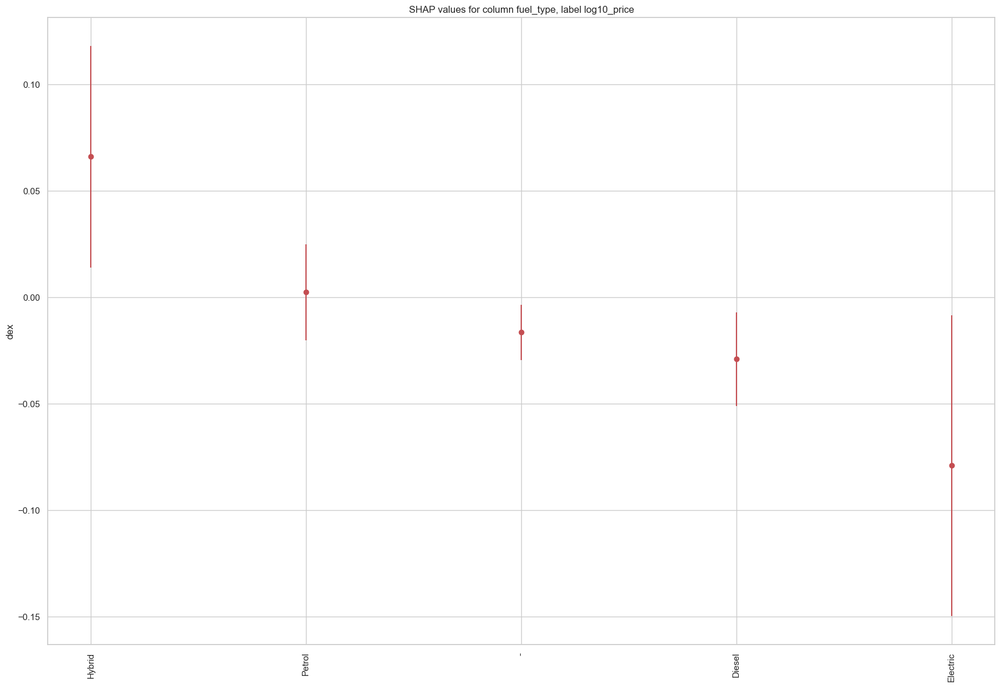

           gain   gain_std  count
col                              
Hybrid    0.0661   0.0520     129
Petrol    0.0024   0.0226   12276
-        -0.0164   0.0130      12
Diesel   -0.0290   0.0220    2676
Electric -0.0790   0.0706     147

engine_size



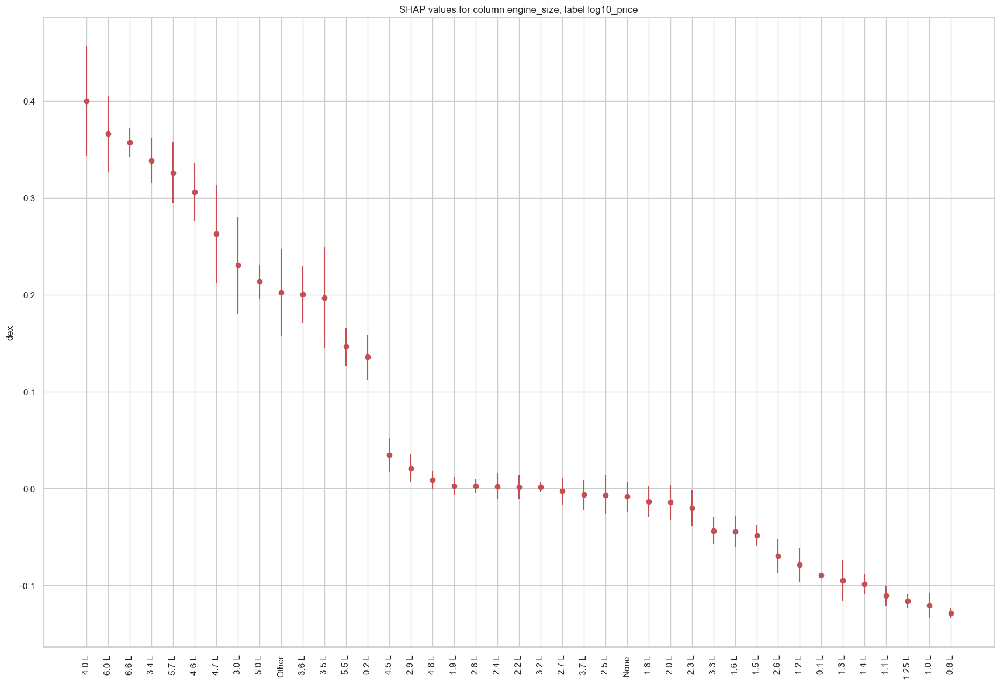

         gain   gain_std  count
col                            
4.0 L   0.3999   0.0568     92 
6.0 L   0.3658   0.0396     25 
6.6 L   0.3571   0.0147     13 
3.4 L   0.3383   0.0237     69 
5.7 L   0.3258   0.0314    112 
4.6 L   0.3058   0.0300     77 
4.7 L   0.2628   0.0508     33 
3.0 L   0.2302   0.0495    704 
5.0 L   0.2135   0.0178     52 
Other   0.2023   0.0448     68 
3.6 L   0.2006   0.0295     50 
3.5 L   0.1969   0.0522    257 
5.5 L   0.1465   0.0196     11 
0.2 L   0.1358   0.0232     90 
4.5 L   0.0345   0.0177     16 
2.9 L   0.0209   0.0145     35 
4.8 L   0.0085   0.0093     13 
1.9 L   0.0030   0.0091     44 
2.8 L   0.0025   0.0073     54 
2.4 L   0.0024   0.0133    656 
2.2 L   0.0018   0.0125    812 
3.2 L   0.0017   0.0050    105 
2.7 L  -0.0030   0.0139    277 
3.7 L  -0.0065   0.0154     11 
2.5 L  -0.0067   0.0204    979 
None   -0.0084   0.0154    704 
1.8 L  -0.0135   0.0155    593 
2.0 L  -0.0142   0.0179   3788 
2.3 L  -0.0202   0.0187    136 
3.3 L  -

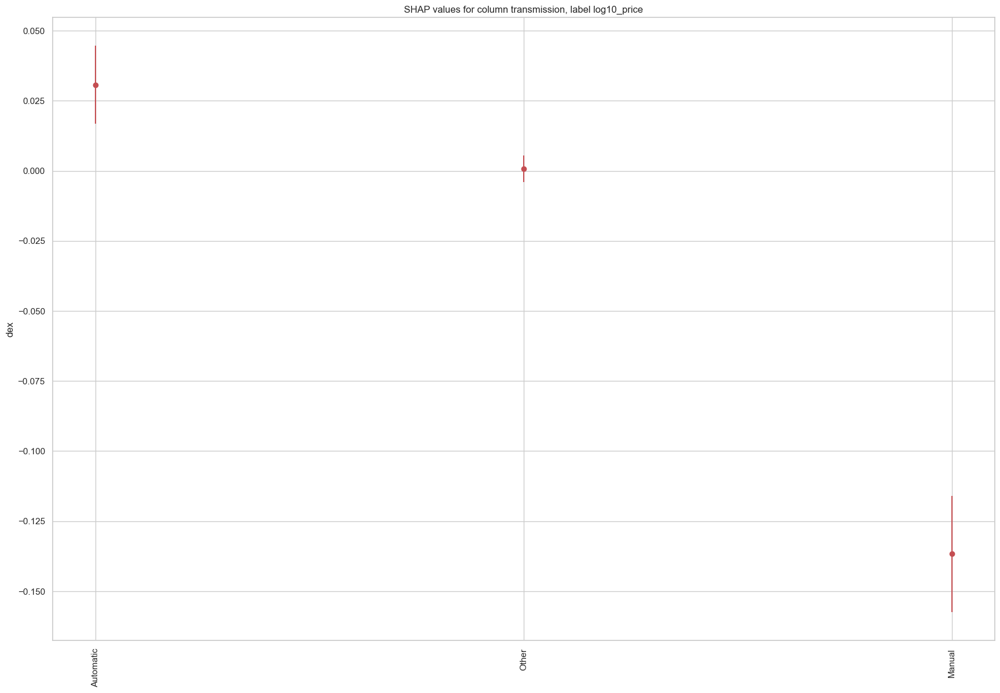

            gain   gain_std  count
col                               
Automatic  0.0307   0.0139   12530
Other      0.0007   0.0047       5
Manual    -0.1367   0.0208    2705

drive_type



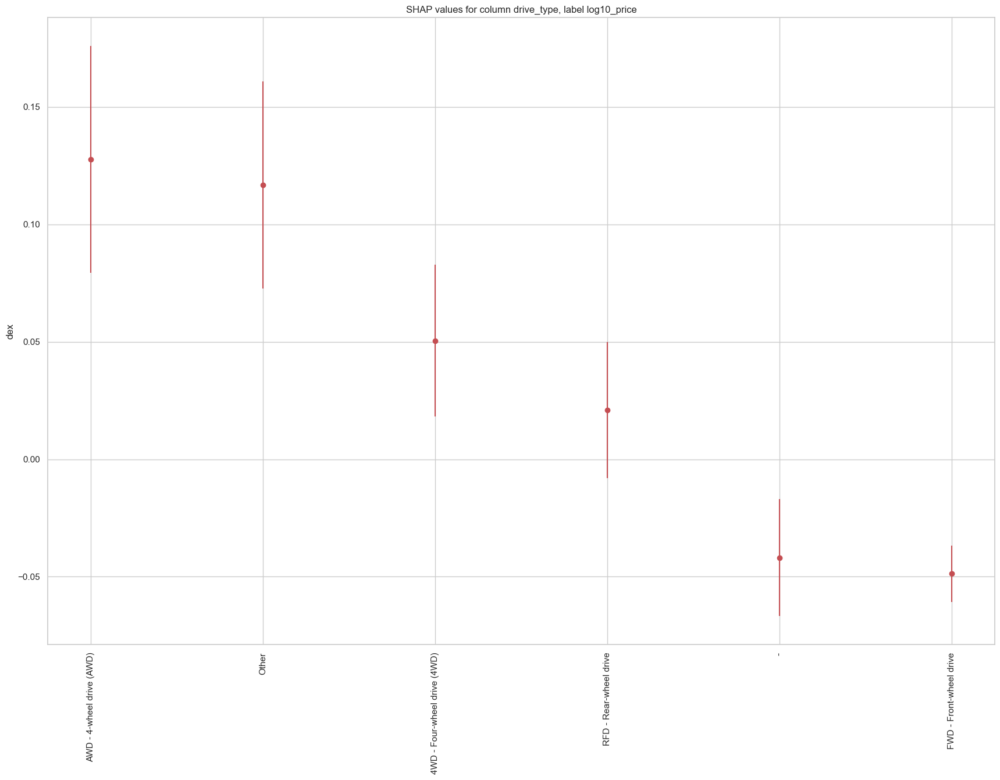

                               gain   gain_std  count
col                                                  
AWD - 4-wheel drive (AWD)     0.1276   0.0483   2224 
Other                         0.1167   0.0441      5 
4WD - Four-wheel drive (4WD)  0.0505   0.0324   1188 
RFD - Rear-wheel drive        0.0209   0.0290   3606 
-                            -0.0419   0.0249     61 
FWD - Front-wheel drive      -0.0487   0.0120   8156 

fuel_consumption



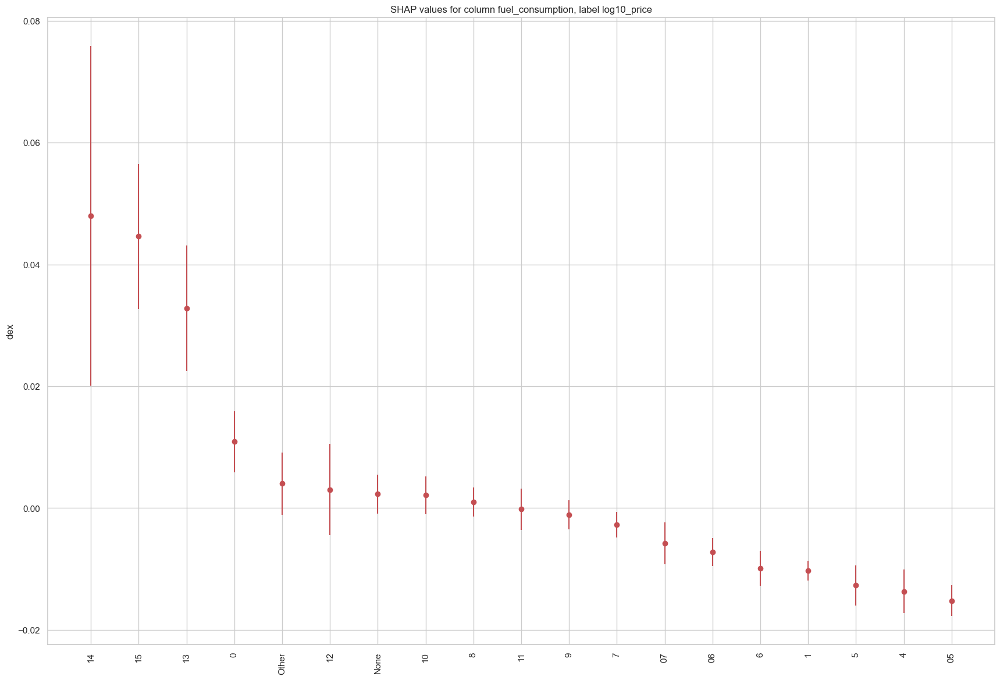

        gain   gain_std  count
col                           
14     0.0480   0.0279     16 
15     0.0446   0.0119     25 
13     0.0328   0.0103     23 
0      0.0109   0.0050     13 
Other  0.0040   0.0051     83 
12     0.0030   0.0075    139 
None   0.0023   0.0032   9609 
10     0.0021   0.0031    340 
8      0.0010   0.0024    958 
11    -0.0002   0.0034     71 
9     -0.0011   0.0024    406 
7     -0.0027   0.0021   1393 
07    -0.0058   0.0034      6 
06    -0.0072   0.0023     18 
6     -0.0099   0.0029   1390 
1     -0.0103   0.0016     10 
5     -0.0127   0.0033    635 
4     -0.0137   0.0036     95 
05    -0.0152   0.0025     10 

brand_grade



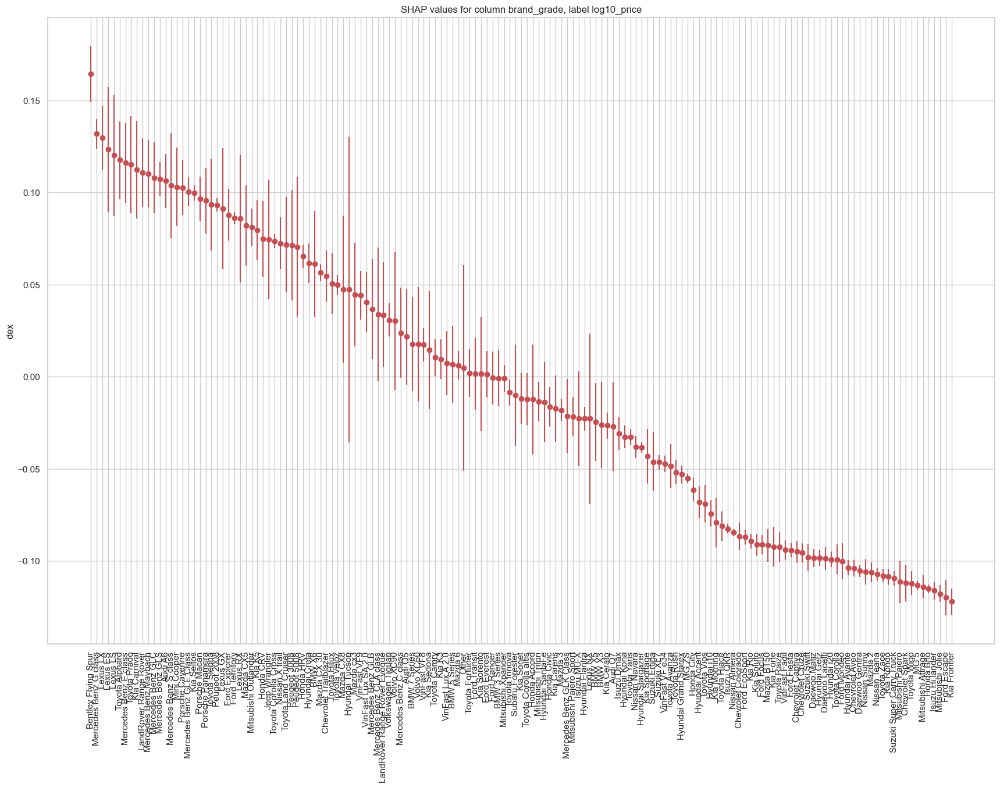

                               gain   gain_std  count
col                                                  
Bentley Flying Spur           0.1643   0.0154     18 
Mercedes Benz G class         0.1318   0.0081     51 
Lexus LX                      0.1296   0.0175    126 
Lexus ES                      0.1233   0.0339     60 
Lexus LS                      0.1202   0.0330     20 
Toyota Alphard                0.1176   0.0210     28 
Mercedes Benz E class         0.1160   0.0217    282 
Toyota Prado                  0.1151   0.0264    101 
Kia Carnival                  0.1124   0.0266     72 
LandRover Range Rover         0.1108   0.0185    114 
Mercedes Benz Maybach         0.1102   0.0182     86 
Mercedes Benz GLC             0.1079   0.0192    390 
Mercedes Benz GLS             0.1072   0.0091     58 
Audi A6                       0.1063   0.0147     19 
Mercedes Benz S class         0.1037   0.0286    231 
Mini Cooper                   0.1029   0.0213     21 
Porsche Cayenne             

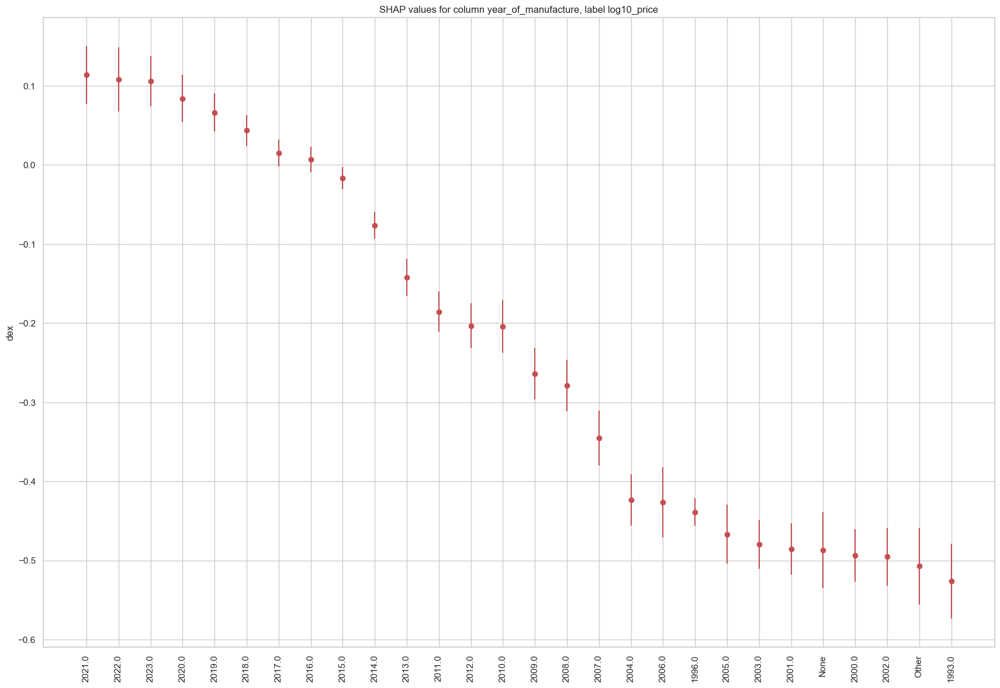

         gain   gain_std  count
col                            
2021.0  0.1137   0.0364   1375 
2022.0  0.1082   0.0404   1829 
2023.0  0.1057   0.0317   2027 
2020.0  0.0840   0.0302   1320 
2019.0  0.0663   0.0240   1487 
2018.0  0.0436   0.0196   1184 
2017.0  0.0151   0.0169    886 
2016.0  0.0067   0.0162    965 
2015.0 -0.0169   0.0140    690 
2014.0 -0.0766   0.0171    513 
2013.0 -0.1423   0.0236    336 
2011.0 -0.1856   0.0254    411 
2012.0 -0.2033   0.0283    213 
2010.0 -0.2041   0.0333    385 
2009.0 -0.2641   0.0322    456 
2008.0 -0.2789   0.0327    298 
2007.0 -0.3453   0.0346    205 
2004.0 -0.4236   0.0327    118 
2006.0 -0.4263   0.0441    102 
1996.0 -0.4388   0.0172      7 
2005.0 -0.4669   0.0374    135 
2003.0 -0.4798   0.0309    103 
2001.0 -0.4855   0.0326     31 
None   -0.4869   0.0482     13 
2000.0 -0.4937   0.0334     30 
2002.0 -0.4952   0.0365     38 
Other  -0.5071   0.0482     70 
1993.0 -0.5262   0.0472     13 


In [22]:
# Define a function named 'show_shap' that visualizes SHAP values for a specific feature.
# Parameters:
#   - col: The name of the feature for which SHAP values will be visualized.
#   - shap_values: SHAP values calculated for the model's predictions.
#   - label: The label to be displayed in the plot title.
#   - X_test: The DataFrame containing the test data.
#   - ylabel: The label for the y-axis in the plot (default is 'points').
def show_shap(col, shap_values=shap_values, label=main_label, X_test=X_test, ylabel='dex'):
    # Create a copy of the test data DataFrame.
    df_infl = X_test.copy()
    
    # Add a new column 'shap_' to the DataFrame containing SHAP values for the specified feature.
    df_infl['shap_'] = shap_values[:, df_infl.columns.tolist().index(col)]
    
    # Calculate the mean SHAP values and standard deviation grouped by the specified feature.
    gain = round(df_infl.groupby(col)['shap_'].mean(), 4)
    gain_std = round(df_infl.groupby(col)['shap_'].std(), 4)
    
    # Count the number of data points for each category of the specified feature.
    cnt = df_infl.groupby(col)['shap_'].count()
    
    # Create a dictionary containing the feature, mean SHAP values, standard deviation, and count.
    dd_dict = {'col': list(gain.index), 'gain': list(gain.values), 'gain_std': list(gain_std.values), 'count': cnt}
        
    # Create a DataFrame from the dictionary and sort it by 'gain' in descending order.
    df_res = pd.DataFrame.from_dict(dd_dict).sort_values('gain', ascending=False).set_index('col')
    
    # Replace "$" by "*" to use in matplotlib
    if any([('$' in str(idx)) for idx in set(df_res.index)]):
        print('Replacing "$" by "*" to use in matplotlib')
        df_res.index = [c.replace('$','*') for c in df_res.index]
    
    
    # Create a plot to visualize the SHAP values with error bars.
    plt.figure(figsize=(21, 14))
    plt.errorbar(df_res.index, df_res['gain'].values, yerr=df_res['gain_std'].values, fmt="o", color="r")
    
    # Set plot title and axis labels.
    plt.title(f'SHAP values for column {col}, label {label}')
    plt.ylabel(ylabel)
    plt.tick_params(axis="x", rotation=90)
    
    # Display the plot and the DataFrame with results.
    plt.show()
    print(df_res)
    
    # Return the function.
    return

# Loop through the columns in the test data.
for col in X_test.columns:
    if col.split('_')[0] not in ['video']: # Avoid previously visialised column(s)
        print()  # Print an empty line for better readability.
        print(col)  # Print the name of the current column.
        print()  # Print another empty line for separation.

        # Call the 'show_shap' function to visualize SHAP values for the current column.
        show_shap(col, shap_values, label=main_label, X_test=X_test)

Deployment model in website using Waston Machine Learning

In [51]:
#Save the best model
model.save_model("best_model")